In [1]:
%load_ext autoreload
%autoreload 2

## Basic setup

In [8]:
import Concord as ccd
import scanpy as sc
import torch
import warnings
warnings.filterwarnings('ignore')

data_path = "../data/intestine_dev/intestine_adata.h5ad"
adata = sc.read(
    data_path
)

adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
ccd.ul.score_cell_cycle(adata, organism='Mm')

Concord - INFO - Processed 43 human genes to mouse orthologs.
Concord - INFO - Processed 54 human genes to mouse orthologs.


In [9]:
adata2 = sc.read(
    "../data/intestine_dev/intestine_adata_concord_concord_Huycke_intestine_Oct07.h5ad"
)

In [10]:
adata.obsm = adata2.obsm

In [7]:
import time
from pathlib import Path
proj_name = "concord_Huycke_intestine"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
file_suffix = f"{proj_name}_{time.strftime('%b%d')}"
seed = 0

## PCA->UMAP

In [32]:
import scanpy as sc
adata_sc = adata.copy()
sc.pp.highly_variable_genes(adata_sc, n_top_genes=10000)  # Identify highly variable genes
sc.tl.pca(adata, svd_solver="arpack")
sc.pp.neighbors(adata_sc, n_neighbors=30)  
sc.tl.umap(adata_sc, min_dist=0.1)
adata.obsm = adata_sc.obsm 

In [ ]:
show_basis = f'X_umap'
show_cols = ['MouseAge_combined', 'seg_classify', 'phase', 'batch', 'cell_type', "mes_subtype"]
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,9), dpi=600, ncols=3, font_size=5, point_size=1, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

## Define feature input and estimate dropout rate in data

Dropout is one of the major patterns in single cell data. Even nearby cells can have significant proportion of non-overlapping non-zero genes, which could be due to technical drop-out or real biology (genes stochastically turned on or off). Concord 'augments' the data by introducing dropout to each of the cell, and use contrastive learning to 'self-supervise' the model to learn the cell identity despite the presence of dropout. The augment dropout probability can be custom-defined, or be estimated based on the average dropout rate in the current data. Here we provide a detailed example how this is calculated:

Concord.utils.feature_selector - INFO - Selecting highly variable features with flavor seurat_v3...
Concord.utils.preprocessor - INFO - Data is already log1p transformed. Skip normalization.
Concord.utils.preprocessor - INFO - Data is already log1p transformed. Storing in the specified layer.
Concord.utils.preprocessor - INFO - Filtering features with provided list (10000 features)...
Concord - INFO - Using existing embedding 'X_pca' from adata.obsm


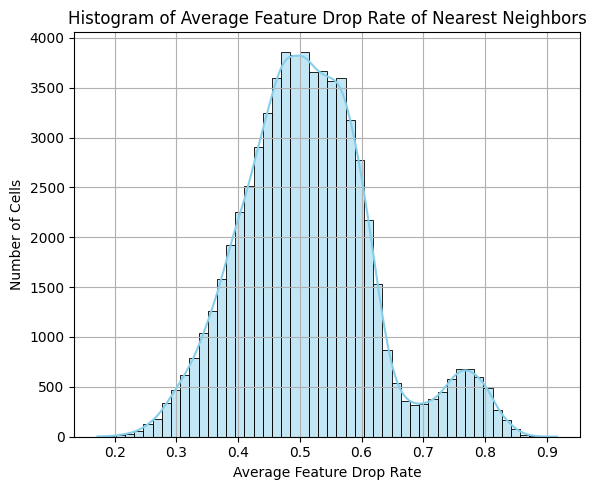

Concord - INFO - Average feature drop rate of nearest neighbors: 0.5134919385795118


In [17]:
# Select top variably expressed/accessible features for analysis (other methods besides seurat_v3 available)
output_key = 'Concord'
feature_list = ccd.ul.select_features(adata, n_top_features=10000, flavor='seurat_v3')
# Determine augmentation mask probabilities based on estimated dropout rate from knn neighbors
dropout_est = ccd.ul.estimate_aug_mask_prob(adata, input_feature = feature_list, n_samples = adata.n_obs, return_mean=False, plotting=True)


In [19]:
# Save for concord run and visualization
adata.obs['dropout_est'] = dropout_est
aug_prob = dropout_est.mean()
aug_prob

0.5134919385795118

Here's one specific example showing the gene set difference between a cell and its 3 nearest neighbors.

In [73]:
from Concord.model.knn import Neighborhood
import numpy as np
emb = adata.obsm['X_pca']
neighborhood = Neighborhood(emb=emb, k=3)
core_samples = np.array([9000])
X = adata.X.toarray()
avg_distances = neighborhood.average_knn_distance(core_samples, X, k=3, distance_metric='drop_diff')
print(avg_distances)
indices = neighborhood.get_knn_indices(core_samples, k=3, include_self=False)
print(adata.obs['cell_type'].iloc[core_samples])
print(adata.obs['cell_type'].iloc[indices.flatten()])


Concord.model.knn - INFO - Using FAISS CPU index.
Concord.model.knn - INFO - Building Faiss FlatL2 index.
Concord.model.knn - INFO - Using FAISS CPU index.


array([0.4884242])

## Run Concord

In [22]:
cur_ccd = ccd.Concord(adata=adata, input_feature=feature_list, domain_key='LaneID', 
                      latent_dim=32,
                      augmentation_mask_prob = aug_prob, 
                      clr_temperature = .3, # Check out advanced usage to learn what this parameter controls
                      p_intra_domain=1.0, 
                      seed=seed, 
                      inplace=False, 
                      verbose=True, 
                      device=device,
                      save_dir=save_dir) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
cur_ccd.encode_adata(input_layer_key='X_log1p', output_key=output_key)

# Save the latent embedding to a filem, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")
adata.obsm = cur_ccd.adata.obsm # If not inplace

Concord - INFO - Setting sampler_knn to 1309 to be 1/50 the number of cells in the dataset. You can change this value by setting sampler_knn in the configuration.
Concord - INFO - Column 'LaneID' is already of type: category
Concord - INFO - Unused levels dropped for column 'LaneID'.
Concord - INFO - Encoder input dim: 10000
Concord - INFO - Decoder input dim: 40
Concord - INFO - Model loaded to device: cuda:0


Concord - INFO - Total number of parameters: 2590128
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Data is already log1p transformed. Skip normalization.
Concord.utils.preprocessor - INFO - Data is already log1p transformed. Storing in the specified layer.
Concord.utils.preprocessor - INFO - Filtering features with provided list (10000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 65468 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - INFO - Using FAISS CPU index.
Concord.model.knn - INFO - Building Faiss IVF index. nprobe=10
Concord.model.knn - INFO - Using FAISS CPU index.
Concord.model.dataloader - INFO - Number of unique_domains: 6
Concord.model.dataloader - INFO - Final p_intra_domain values: L1: 1.00, L2: 1.00, Live_1: 1.00, Live_2: 1.00, R: 1.00, Rare: 1.00
Concord - INFO - Starting epoch 1/5
Concord - 

Epoch 0 Training: 1020it [00:24, 42.10it/s, loss=3.05]

Concord - INFO - Epoch   0 | Train Loss: 3.33, MSE: 0.09, CLASS: 0.00, CONTRAST: 3.24, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 2/5
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 65468


Epoch 1 Training: 100%|██████████| 1020/1020 [00:24<00:00, 41.20it/s, loss=3.06]

Concord - INFO - Epoch   1 | Train Loss: 2.99, MSE: 0.06, CLASS: 0.00, CONTRAST: 2.93, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 3/5
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 65468


Epoch 2 Training: 100%|██████████| 1020/1020 [00:24<00:00, 41.46it/s, loss=2.94]

Concord - INFO - Epoch   2 | Train Loss: 2.94, MSE: 0.06, CLASS: 0.00, CONTRAST: 2.88, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 4/5
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 65468


Epoch 3 Training: 100%|██████████| 1020/1020 [00:24<00:00, 42.43it/s, loss=3.09]

Concord - INFO - Epoch   3 | Train Loss: 2.91, MSE: 0.06, CLASS: 0.00, CONTRAST: 2.85, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 5/5
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 65468


Epoch 4 Training: 100%|██████████| 1020/1020 [00:23<00:00, 43.09it/s, loss=3.05]

Concord - INFO - Epoch   4 | Train Loss: 2.89, MSE: 0.06, CLASS: 0.00, CONTRAST: 2.83, IMPORTANCE: 0.00


Concord - INFO - Model saved to ../save/dev_concord_Huycke_intestine-Oct07/final_model.pth
Concord - INFO - Final model saved at: ../save/dev_concord_Huycke_intestine-Oct07/final_model.pth; Configuration saved at: ../save/dev_concord_Huycke_intestine-Oct07/config.json.
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Data is already log1p transformed. Skip normalization.
Concord.utils.preprocessor - INFO - Data is already log1p transformed. Storing in the specified layer.
Concord.utils.preprocessor - INFO - Filtering features with provided list (10000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 65468 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1


## Visualize Concord latent with UMAP

In [4]:
#import scanpy as sc
#adata = sc.read("../data/intestine_dev/intestine_adata_concord_processed.h5ad")

### 2D UMAP

In [25]:
adata.obs[['PC1', 'PC2', 'PC3']] = adata.obsm['X_pca'][:, :3]
adata.obs[['Concord1', 'Concord2', 'Concord3']] = adata.obsm['Concord'][:, :3]


In [ ]:
show_basis = f'X_umap'
show_cols = ['PC1', 'PC2', 'PC3', 'Concord1', 'Concord2', 'Concord3']
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,8), dpi=600, ncols=3, font_size=5, point_size=1, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [ ]:
show_basis = f'{output_key}_UMAP'
show_cols = ['PC1', 'PC2', 'PC3', 'Concord1', 'Concord2', 'Concord3']
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,8), dpi=600, ncols=3, font_size=5, point_size=1, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [23]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
show_cols = ['MouseAge_combined', 'seg_classify', 'phase', 'batch', 'cell_type', "mes_subtype", "dropout_est"]
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,12), dpi=600, ncols=3, font_size=5, point_size=1, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


### 3D UMAP

It is best to use 3D UMAP rather than 2D to visualize Concord latent, because 2D may not be enough to 'unpack' the complex structures learned by Concord, thus tends to break trajectories.

In [ ]:
import plotly.io as pio
pio.renderers.default = 'notebook'
ccd.ul.run_umap(adata,  source_key=output_key, umap_key=f'{output_key}_UMAP_3D', n_components=3, n_neighbors=15, min_dist=0.1, metric='euclidean')

# Plot the 3D UMAP embeddings
#show_cols = ['MouseAge_combined', 'seg_classify', 'phase', 'batch', 'cell_type', "mes_subtype"]
col = 'cell_type'
show_basis = f'{output_key}_UMAP_3D'
ccd.pl.plot_embedding_3d(
        adata, basis=show_basis, color_by=col,
        save_path=save_dir / f'{show_basis}_{file_suffix}.html',
        point_size=1, opacity=0.8, width=1500, height=1000
    )

In [36]:
col = 'phase'
show_basis = f'{output_key}_UMAP_3D'
ccd.pl.plot_embedding_3d(
        adata, basis=show_basis, color_by=col,
        save_path=save_dir / f'{show_basis}_{file_suffix}.html',
        point_size=1, opacity=0.8, width=1500, height=1000
    )

Concord - INFO - 3D plot saved to ../save/dev_concord_Huycke_intestine-Oct07/Concord_UMAP_3D_concord_Huycke_intestine_Oct07_phase.html


We can just visualize the Mesenchmal cell (Pdgfra hi/lo) subset, note the loop of cell cycle and the differentiation from Pdgfra-lo to Pdgfra-hi cells.

In [26]:
col = 'mes_subtype'
show_basis = f'{output_key}_UMAP_3D'
ccd.pl.plot_embedding_3d(
        adata, basis=show_basis, color_by=col,
        save_path=save_dir / f'{show_basis}_{file_suffix}.html',
        point_size=1, opacity=0.8, width=1500, height=800
    )

Concord - INFO - 3D plot saved to ../save/dev_concord_Huycke_intestine-Oct07/Concord_UMAP_3D_concord_Huycke_intestine_Oct07_mes_subtype.html


## Importance of features learned by Concord

In [ ]:
ccd.pl.visualize_importance_weights(
    cur_ccd.model, adata, top_n=30, mode='histogram',
    save_path=save_dir / f"importance_weights_histogram_{file_suffix}.png"
)
ccd.pl.visualize_importance_weights(
    cur_ccd.model, adata, top_n=12, mode='highest',
    save_path=save_dir / f"importance_weights_highest_{file_suffix}.png"
)

## Intepretable latent learned by Concord

In [76]:
# Downsample data to a small subset for fast estimation of feature contribution to the latent space
import numpy as np
adata_subset = adata.copy()[np.random.choice(adata.n_obs, 1000, replace=False), cur_ccd.config.input_feature]
input_tensors = torch.tensor(adata_subset.layers['X_log1p'].A).to(cur_ccd.config.device)
importance_matrix = ccd.ul.compute_feature_importance(cur_ccd.model, input_tensors, layer_index=4)
importance_matrix.shape

(10000, 32)

In [ ]:
# Plot features with most variation in contribution to the latent space
var_importance = importance_matrix.var(axis=1)
top_features = np.argsort(var_importance)[::-1][:300]
importance_matrix_top = importance_matrix[top_features]
top_feature_names = adata_subset.var.index[top_features]
ccd.pl.plot_importance_heatmap(importance_matrix_top, top_feature_names, save_path=save_dir / f"importance_heatmap_{file_suffix}.png")

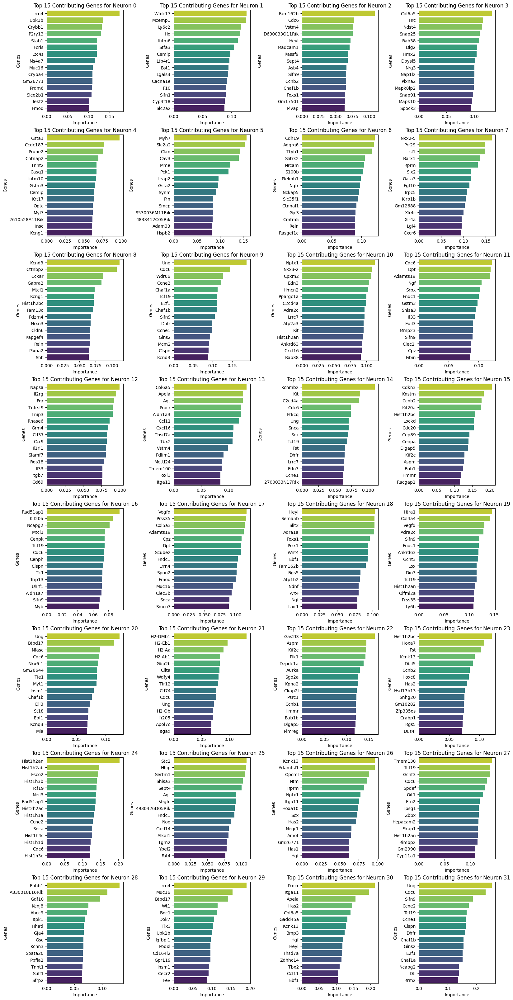

In [86]:
ccd.pl.plot_top_genes_per_neuron(importance_matrix, adata, top_n=15, ncols=4, save_path=save_dir/"gsea_bar")

In [91]:
ranked_lists = ccd.ul.prepare_ranked_list(importance_matrix, input_features=adata_subset.var.index)

In [ ]:
show_basis = 'Concord_UMAP'
ccd.pl.plot_top_genes_embedding(adata, ranked_lists, show_basis, top_x=4, figsize=(5, 1.2), point_size=1,
                         save_path=save_dir / f"embeddings_{show_basis}")

In [108]:
ranked_lists_first5

{'Neuron 0':         Gene  Importance
 0      Lrrn4    0.173732
 1      Upk1b    0.134466
 2     Crybb1    0.131845
 3     P2ry13    0.129231
 4      Stab1    0.120786
 ...      ...         ...
 9995   Napsa   -0.084364
 9996     Fgr   -0.089978
 9997  Ifitm6   -0.090368
 9998      Hp   -0.092356
 9999    Heyl   -0.105502
 
 [10000 rows x 2 columns],
 'Neuron 1':         Gene  Importance
 0     Wfdc17    0.126092
 1     Mcemp1    0.125224
 2      Ly6c2    0.116633
 3         Hp    0.115220
 4     Ifitm6    0.111189
 ...      ...         ...
 9995    Mcm3   -0.079286
 9996    Mcm2   -0.085782
 9997    Cdc6   -0.094959
 9998     Fst   -0.119544
 9999     Ung   -0.120536
 
 [10000 rows x 2 columns],
 'Neuron 2':                Gene  Importance
 0           Fam162b    0.108533
 1              Cdc6    0.077534
 2             Vstm4    0.076070
 3     D630033O11Rik    0.075828
 4              Heyl    0.072412
 ...             ...         ...
 9995          Hook2   -0.069034
 9996          Ptp

In [111]:
adata.var.index

Index(['Gm1992', 'Sox17', 'Oprk1', 'Alkal1', 'St18', 'Pcmtd1', 'Gm26901',
       'Sntg1', 'Sgk3', 'Mcmdc2',
       ...
       'mt-Nd3', 'mt-Nd4l', 'mt-Nd4', 'mt-Nd5', 'mt-Nd6', 'mt-Cytb',
       'AC168977.1', 'Csprs', 'AC132444.6', 'AC149090.1'],
      dtype='object', length=10000)

In [113]:
mouse_to_human_dict = ccd.ul.get_human_genes(adata.var.index, return_type='dict')

Concord - INFO - Processed 100 mouse genes to human orthologs.
Concord - INFO - Processed 200 mouse genes to human orthologs.
Concord - INFO - Processed 300 mouse genes to human orthologs.
Concord - INFO - Processed 400 mouse genes to human orthologs.
Concord - INFO - Processed 500 mouse genes to human orthologs.
Concord - INFO - Processed 600 mouse genes to human orthologs.
Concord - INFO - Processed 700 mouse genes to human orthologs.
Concord - INFO - Processed 800 mouse genes to human orthologs.
Concord - INFO - Processed 900 mouse genes to human orthologs.
Concord - INFO - Processed 1000 mouse genes to human orthologs.
Concord - INFO - Processed 1100 mouse genes to human orthologs.
Concord - INFO - Processed 1200 mouse genes to human orthologs.
Concord - INFO - Processed 1300 mouse genes to human orthologs.
Concord - INFO - Processed 1400 mouse genes to human orthologs.
Concord - INFO - Processed 1500 mouse genes to human orthologs.
Concord - INFO - Processed 1600 mouse genes to hu

In [115]:
{k: pd.Series(mouse_to_human_dict(v['Gene'])) for k, v in ranked_lists_first5.items()}

TypeError: 'dict' object is not callable

In [118]:
import pandas as pd
# Extract first 5 out of ranked_lists (dictionary)
ranked_lists_first5 = {k: ranked_lists[k] for k in list(ranked_lists)[:5]}
# Convert mouse genes to human genes
for key, df in ranked_lists_first5.items():
    # Map mouse genes to human genes using mouse_to_human_dict
    df['Gene'] = df['Gene'].map(mouse_to_human_dict).fillna(df['Gene'])
ranked_lists_first5

{'Neuron 0':         Gene  Importance
 0      LRRN4    0.173732
 1      UPK1B    0.134466
 2     CRYBB1    0.131845
 3     P2RY13    0.129231
 4      STAB1    0.120786
 ...      ...         ...
 9995   NAPSA   -0.084364
 9996     FGR   -0.089978
 9997  IFITM3   -0.090368
 9998      HP   -0.092356
 9999    HEYL   -0.105502
 
 [10000 rows x 2 columns],
 'Neuron 1':         Gene  Importance
 0     Wfdc17    0.126092
 1     MCEMP1    0.125224
 2       LY6S    0.116633
 3         HP    0.115220
 4     IFITM3    0.111189
 ...      ...         ...
 9995    MCM3   -0.079286
 9996    MCM2   -0.085782
 9997    CDC6   -0.094959
 9998     FST   -0.119544
 9999     UNG   -0.120536
 
 [10000 rows x 2 columns],
 'Neuron 2':                Gene  Importance
 0           FAM162B    0.108533
 1              CDC6    0.077534
 2             VSTM4    0.076070
 3     D630033O11Rik    0.075828
 4              HEYL    0.072412
 ...             ...         ...
 9995          HOOK2   -0.069034
 9996          PTP

In [119]:
all_gsea_results = ccd.ul.run_gsea_for_all_neurons(ranked_lists_first5, gene_sets='GO_Biological_Process_2021', outdir=save_dir/'GSEA_results')
gsea_tbls = ccd.ul.get_gsea_tables(all_gsea_results)

2024-10-07 22:52:32,056 [WARNING] Duplicated values found in preranked stats: 0.02% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


Running GSEA for Neuron 0...


2024-10-07 22:53:19,765 [WARNING] Duplicated values found in preranked stats: 0.02% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


Running GSEA for Neuron 1...


2024-10-07 22:54:07,888 [WARNING] Duplicated values found in preranked stats: 0.01% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


Running GSEA for Neuron 2...


2024-10-07 22:54:57,944 [WARNING] Duplicated values found in preranked stats: 0.01% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


Running GSEA for Neuron 3...
Running GSEA for Neuron 4...


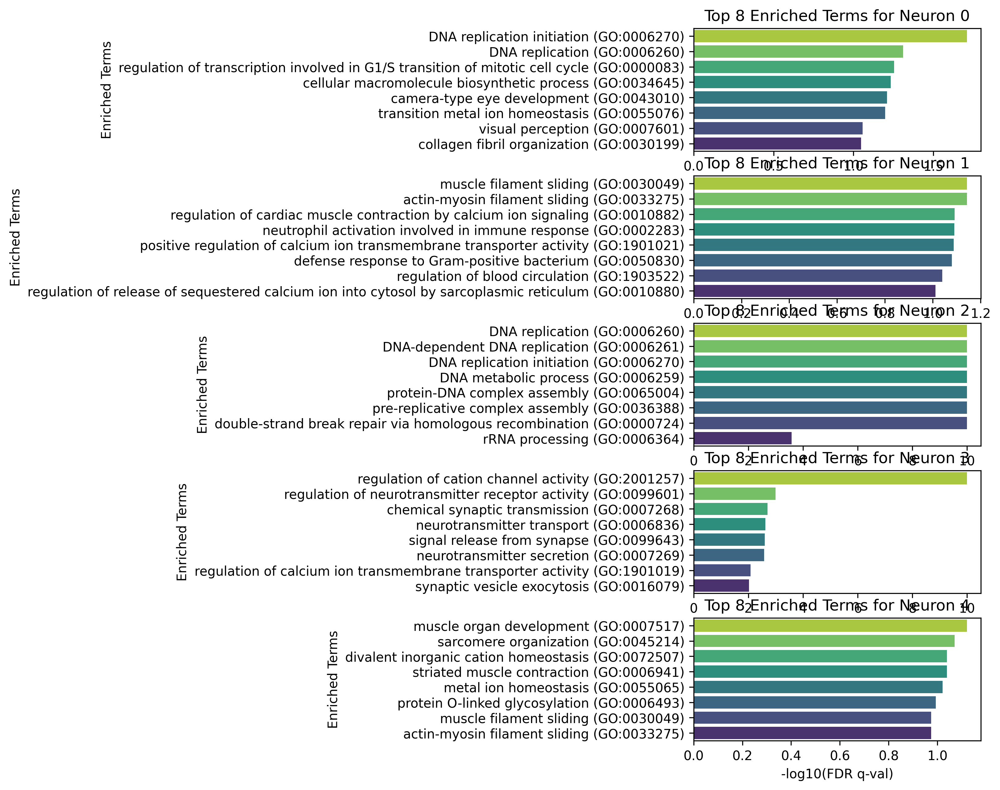

In [122]:
ccd.pl.plot_all_top_enriched_terms(gsea_tbls, top_n=8,figsize=(4, 2), font_size=10, color_palette='viridis_r', save_path=save_dir/"gsea_bar_")

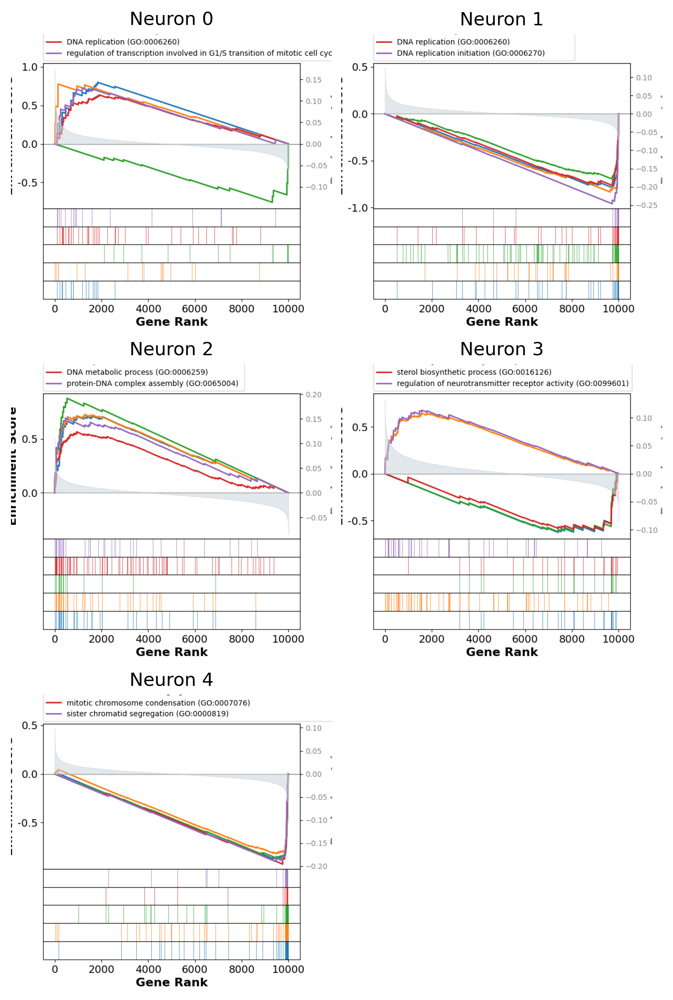

In [121]:
ccd.pl.plot_all_top_gsea_results(all_gsea_results, terms_per_plot=5, ncols=2, figsize_per_plot=(3, 3), save_path=save_dir/"gsea_res")

## Save the result

In [27]:
save_dir

PosixPath('../save/dev_concord_Huycke_intestine-Oct07')

In [35]:
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(adata, obsm_filename)
adata.write_h5ad(f"../data/intestine_dev/intestine_adata_concord_{file_suffix}.h5ad")

You can optionally convert the result to VisCello (https://github.com/kimpenn/VisCello) for interactive exploration.

In [12]:
ccd.ul.anndata_to_viscello(adata, Path('../data/intestine_dev/') / f"cello_{proj_name}_{file_suffix}", project_name = proj_name, organism='mmu')

Concord - INFO - Normalized expression data (adata.layers['X_log1p']) not found. Renormalize and log transforming.
VisCello project created at ../data/intestine_dev/cello_concord_Huycke_intestine_concord_Huycke_intestine_Oct14
